In [17]:
import os

imdb_dir = '../keras_dataset/aclImdb/'
train_dir = os.path.join(imdb_dir,'train')
#print(train_dir) 
#> './keras_dataset/aclImdb/train'
labels = []
texts = []

In [18]:
for label_type in ['neg', 'pos']:
    dir_name = os.path.join(train_dir, label_type)
    
    for fname in os.listdir(dir_name):
        if fname[-4:] == '.txt':
            f = open(os.path.join(dir_name, fname), encoding='utf8')
            texts.append(f.read())
            f.close()
            
            if label_type == 'neg':
                labels.append(0)
            else:
                labels.append(1)

In [19]:
print(texts[0])
print("===========")
print(texts[0].split(' '))
print("===========")
print(len(texts[0].split(' ')))
print("===========")
print(['negative','positive'][labels[0]])

Fans of goremeister Herschell Gordon Lewis should look elsewhere if they are picking up this film for his usual buckets of blood being sloshed about, for there is precious little in the way of bloodletting in this film. Instead, Lewis decides to try and tell the bizarre story, relying on bargain-basement special effects on a budget which could have probably been doubled if the cast had turned out their pockets for change one day. Oddly enough, while cheap and very poorly acted (especially by McCabe as Mitchell), the total outlandishness of the plot keeps attention throughout. Imagine what this film could have been like with a decent budget! Overall, it strains for champagne tastes on a beer budget.
['Fans', 'of', 'goremeister', 'Herschell', 'Gordon', 'Lewis', 'should', 'look', 'elsewhere', 'if', 'they', 'are', 'picking', 'up', 'this', 'film', 'for', 'his', 'usual', 'buckets', 'of', 'blood', 'being', 'sloshed', 'about,', 'for', 'there', 'is', 'precious', 'little', 'in', 'the', 'way', 'o

In [20]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
import numpy as np

In [21]:
maxlen = 100
training_samples = 200
validation_samples = 10000
max_words = 10000

In [22]:
# build a word index
tokenizer = Tokenizer(num_words=max_words)
tokenizer.fit_on_texts(texts)

# word sequences -> a list of integer list
sequences = tokenizer.texts_to_sequences(texts)

word_index = tokenizer.word_index
print("the number of word index : %s" % len(word_index))

the number of word index : 88582


In [23]:
print(sequences[0])
print('============')
print(len(sequences[0]))

[448, 4, 2232, 2070, 141, 165, 3285, 44, 33, 23, 3606, 53, 11, 19, 15, 24, 641, 4, 538, 109, 41, 15, 47, 6, 3657, 114, 8, 1, 93, 4, 8, 11, 19, 302, 2070, 1065, 5, 350, 2, 373, 1, 1158, 62, 7476, 20, 4844, 3210, 315, 299, 20, 3, 349, 60, 97, 25, 239, 74, 44, 1, 174, 66, 676, 43, 65, 15, 649, 28, 248, 2974, 192, 134, 702, 2, 52, 858, 914, 258, 31, 14, 3712, 1, 959, 4, 1, 111, 938, 688, 466, 835, 48, 11, 19, 97, 25, 74, 37, 16, 3, 539, 349, 441, 9, 15, 5171, 20, 3, 3626, 349]
108


In [24]:
data = pad_sequences(sequences, maxlen=maxlen)
print(type(labels))
labels = np.asarray(labels)
print(type(labels))
print(data.shape)
print(labels.shape)

<class 'list'>
<class 'numpy.ndarray'>
(25000, 100)
(25000,)


In [60]:
indices = np.arange(data.shape[0])
np.random.shuffle(indices)

data = data[indices]
labels = labels[indices]

In [68]:
# In this example,
# we only use 200 samples for training 
# and use 10,000 samples for validation

x_train = data[:training_samples]
y_train = labels[:training_samples]

x_val = data[training_samples: training_samples + validation_samples]
y_val = labels[training_samples: training_samples + validation_samples]

### using GloVe word embedding

In [ ]:
glove_dir = '../keras_dataset/glove/'

embeddings_index = {}
f = open(os.path.join(glove_dir, 'glove.6B.100d.txt'), encoding='utf8')


# contents of f 
# <word> <component_float_#1> <component_float_#2> <component_float_#3> ...<component_float_#n>
for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs

f.close()

print("number of embeddings index : %s" % len(embeddings_index))

the -0.038194 -0.24487 0.72812 -0.39961 0.083172 0.043953 -0.39141 0.3344 -0.57545 0.087459 0.28787 -0.06731 0.30906 -0.26384 -0.13231 -0.20757 0.33395 -0.33848 -0.31743 -0.48336 0.1464 -0.37304 0.34577 0.052041 0.44946 -0.46971 0.02628 -0.54155 -0.15518 -0.14107 -0.039722 0.28277 0.14393 0.23464 -0.31021 0.086173 0.20397 0.52624 0.17164 -0.082378 -0.71787 -0.41531 0.20335 -0.12763 0.41367 0.55187 0.57908 -0.33477 -0.36559 -0.54857 -0.062892 0.26584 0.30205 0.99775 -0.80481 -3.0243 0.01254 -0.36942 2.2167 0.72201 -0.24978 0.92136 0.034514 0.46745 1.1079 -0.19358 -0.074575 0.23353 -0.052062 -0.22044 0.057162 -0.15806 -0.30798 -0.41625 0.37972 0.15006 -0.53212 -0.2055 -1.2526 0.071624 0.70565 0.49744 -0.42063 0.26148 -1.538 -0.30223 -0.073438 -0.28312 0.37104 -0.25217 0.016215 -0.017099 -0.38984 0.87424 -0.72569 -0.51058 -0.52028 -0.1459 0.8278 0.27062

, -0.10767 0.11053 0.59812 -0.54361 0.67396 0.10663 0.038867 0.35481 0.06351 -0.094189 0.15786 -0.81665 0.14172 0.21939 0.58505 -0.52158

thought 0.27976 0.41419 0.30273 -0.33506 -0.64343 0.10279 0.28287 -0.389 0.10772 -0.27527 0.17289 0.48796 0.36295 -0.035375 0.2435 -0.26222 -0.44429 0.36874 -0.49478 0.42968 0.33331 0.38279 -0.13741 -0.66816 -0.047101 0.065524 -0.1943 -0.44047 0.090774 -0.10327 -0.066825 0.77394 0.018293 -0.12589 0.24872 -0.10575 -0.21745 0.48803 0.3394 -0.16673 -0.67534 0.018617 0.4899 -0.41707 -0.29622 -0.058124 0.57627 -0.15973 -0.28399 -1.0066 0.37028 0.019402 0.27252 0.64892 -0.22996 -2.123 -0.1159 0.046414 0.90253 0.83302 0.10904 1.2582 -0.32955 0.0049611 1.0166 -0.035602 0.62182 0.25262 -0.41997 -0.064994 0.069209 -0.099736 0.32192 -0.23348 -0.37536 -0.10131 0.2239 -0.21366 -0.65524 0.12253 -0.065747 0.020918 -0.96033 -0.37422 -1.6779 -0.15718 -0.044965 -0.37923 -0.5347 -0.34246 0.15608 -0.76033 0.16771 -0.1226 -0.59659 -0.17894 -0.53551 -0.51724 -0.17731 0.3057

! 0.38472 0.49351 0.49096 -1.5434 -0.33614 0.6222 0.32265 0.075331 0.65591 -0.23517 1.2114 0.06193 -0.62004 0.31371 0.38948 -0.24381 -

supported -0.51394 0.93877 -0.93668 0.32606 0.57069 -0.0040181 -0.43532 -0.060201 -0.13642 -0.18433 0.32888 -0.38006 0.10961 -0.47304 0.1035 -0.40629 -0.35667 -0.38612 -0.57812 0.010465 -0.075569 -0.24492 0.30553 -0.0081069 -0.13891 -0.46798 -0.18446 -0.59212 0.13967 0.38339 0.76558 0.90387 0.077472 0.35617 0.88945 0.20036 0.53054 -0.040176 -0.28258 0.012146 -0.79104 -0.26265 0.68898 0.38508 0.17912 -0.73981 0.18973 -0.14631 -0.11325 -0.64233 -0.021801 0.68258 0.31871 0.63373 0.051357 -1.6748 0.41426 -0.6798 1.077 0.35203 0.099602 -0.49075 0.26129 0.55876 0.61842 -0.16045 -0.18875 0.67318 0.27981 0.27822 0.68335 0.26297 -0.029412 -0.32467 -0.38816 -0.187 0.013524 0.71697 -1.0017 -0.24396 0.1192 0.063912 -0.25402 0.13513 -1.0488 -0.16169 0.076913 -0.11063 -0.22587 -0.56157 -0.092341 -0.99229 -0.36237 0.67156 -0.49553 -0.34448 -0.63011 -0.076484 0.43215 -0.15668

ambassador 0.016786 -0.095771 0.69379 0.26419 0.44444 -0.65217 -0.4191 0.44462 0.43644 0.083485 -0.77516 -0.55468 0.046468 1.0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




hebei 0.65405 0.00055006 0.88951 -0.49405 0.65264 -0.18778 -0.87556 0.73503 0.31097 1.3548 -0.1035 0.016166 1.572 0.068183 -0.38737 -0.46571 0.49314 -0.33776 -0.051705 -0.58796 1.064 -0.042478 -0.17216 0.12307 -1.0145 0.5109 0.14504 1.1768 -0.73104 0.059025 -0.81285 0.16356 1.1859 -0.71556 -0.62964 0.071522 0.073576 -0.20281 -0.83957 -0.49414 -0.37943 -0.095777 -0.1483 -0.96119 0.11358 -0.15187 0.050211 -0.52386 1.1212 -0.11947 -0.39151 -0.2572 -0.19792 0.078757 -0.43844 0.216 -0.35372 -0.8398 0.28189 -0.48814 -0.44351 -0.074885 -0.036455 0.82059 0.1973 0.31724 -0.80495 0.34275 0.022576 0.30436 -0.11253 0.20287 0.36518 0.8639 0.042576 0.26679 0.61809 0.075554 -0.28664 -0.34238 0.39893 1.1862 -0.71703 0.55989 0.16431 0.44886 0.0041377 0.2909 0.29094 0.045809 1.5712 -0.22522 -0.7452 0.057564 -0.42465 0.58268 -1.2348 -0.8803 0.33801 -1.0181

compounded -0.29634 0.077652 0.6459 0.1641 -0.71446 0.084838 -0.21481 -0.10023 0.26369 -0.12762 -0.36369 0.43227 0.072242 -0.42204 0.19526 -0.53854 


hovering -0.23267 0.29004 0.43931 0.65959 -0.28096 0.26348 -0.2565 -0.25781 -0.49502 -0.24824 -0.062742 -0.090394 0.68679 -0.052093 0.50412 -0.91816 -0.25505 0.16864 1.2991 0.35341 -0.048565 0.632 0.083168 0.16076 0.80096 -0.25907 -0.32644 0.12183 -0.45347 -0.26154 0.10358 -0.93177 0.25677 0.84896 0.25153 0.6947 0.12239 -0.53666 1.1384 -0.070882 0.037278 -0.0038638 -0.6023 0.25641 0.95511 0.1619 0.33637 0.40976 -0.41348 -1.0258 0.46566 -0.40278 -0.021204 1.9917 -0.19897 -0.57505 0.39301 -0.17696 0.11865 1.04 0.67488 0.92152 -0.22427 0.21165 -1.0951 1.2138 0.20382 -0.56265 -0.06832 0.45338 -0.33001 -0.67786 0.30172 0.21643 -0.26871 -0.25417 0.18286 -0.2125 -0.2357 0.0075916 0.14234 0.44802 0.00070985 -1.1892 0.43958 -0.81496 0.51342 0.3304 0.40227 -0.09838 -0.5094 0.67861 -0.3506 -0.11276 -0.4254 0.015019 0.0042511 0.078078 0.096936 0.19287

stylish -0.0073352 -0.04274 0.12687 -0.067745 0.099044 0.91217 0.1959 0.20933 -0.48677 1.1331 0.25442 -0.70473 -0.18206 -0.23994 0.41409 0.42029 -


devotees -0.20889 0.46853 -0.34879 -0.36181 -0.041828 1.1858 -0.26242 0.47609 0.14862 -0.36627 -0.58334 -0.12539 0.66661 -0.11031 -0.24254 -1.074 0.28857 0.57223 -0.61006 0.99455 0.14669 -0.77579 -0.27453 0.19595 0.52303 0.28943 0.12453 0.73928 0.39006 -0.48765 0.014849 -0.453 -0.14979 0.31326 0.04336 0.34879 -0.13881 0.67545 0.36078 -0.080758 -0.65824 0.75002 0.43236 -0.38242 0.4418 -0.78041 0.047363 0.21339 0.82695 0.33003 0.4288 -0.45907 0.78207 0.090027 -0.52181 -0.070225 -0.38092 0.05892 0.61872 -0.25805 0.08632 0.64194 0.67986 0.62668 -0.41059 0.62705 0.3212 -0.56467 0.68561 -0.88593 0.24177 -0.1376 -0.35941 -0.33246 -1.0242 -0.058274 -0.21635 -0.28504 0.26147 -0.27935 0.15335 0.015512 -0.25809 -0.1967 -0.87174 0.11739 -0.72491 -0.10836 -0.3301 0.3016 0.30483 -0.075219 0.19612 -0.54635 -0.59037 -1.0456 -0.52217 -0.18912 0.59592 0.82159

californians 0.011802 0.77644 0.60704 -0.39536 7.4314e-05 0.35211 -0.25213 0.36733 0.1624 -0.15591 -0.62845 -0.14451 -0.38434 -1.0502 0.14799 -1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



gazans -0.011498 0.28378 -0.27422 -0.065644 -0.13019 0.19371 -0.25105 0.25967 0.74679 -0.84617 -0.52586 0.088784 0.75569 -0.56064 -0.050862 0.013927 -0.46551 -0.6553 -0.27569 0.39322 0.55662 0.35056 -0.10128 -0.015805 0.8517 -0.70346 -0.14254 -0.063391 0.36695 -0.66966 0.38782 -0.066731 -1.4373 0.14092 -0.13953 -0.33973 0.13428 0.88264 0.087286 0.48977 -0.9296 0.20002 -0.12209 0.42812 0.10889 0.41487 0.030934 0.87479 0.1357 0.38112 0.014385 0.33962 0.84303 0.65871 -0.53215 0.67123 -0.010228 -0.95972 0.47012 -0.33214 -0.063272 -0.29032 0.23471 -0.34254 0.38906 1.2033 0.33336 -0.63442 -0.60184 -1.2088 0.068951 -0.70224 -0.26209 0.29914 -0.4368 0.7368 0.29379 0.64147 -0.091177 -0.43968 1.4377 0.24665 -0.90145 0.78188 -0.65426 0.36467 0.082573 -0.20136 -0.78862 0.58075 0.20335 0.40165 -0.33936 -0.8687 -1.0837 0.16071 0.94319 0.6855 -0.11976 0.86278

1755 0.01004 -0.31157 -0.12767 0.35767 -0.98636 0.084451 0.43097 -0.3749 0.31014 -0.010686 0.59727 -0.207 -0.48266 0.21622 0.6391 -0.04376 -0.

scrutinize -0.4 -0.0010908 -0.23357 0.050803 -0.62707 0.15238 -0.8877 0.28591 -0.1133 -0.055126 0.051489 0.26348 0.36435 -0.44874 -0.67066 0.55001 0.62787 0.40541 0.30517 -0.1637 -0.59941 -0.59414 -0.064582 -0.5224 -0.53801 -0.64232 -0.25665 0.43488 -0.23252 -0.11792 0.30173 -0.26305 -0.046606 0.27114 -0.53207 0.095138 -0.28557 -0.37727 0.073579 -0.19991 -0.076968 -0.47153 -0.33303 0.25987 -1.0382 0.32806 -0.19975 -0.62228 -0.093114 -0.55067 0.59736 0.46163 0.038622 0.52565 -0.39129 0.48832 0.59288 -0.38791 0.17307 -0.30032 -0.58409 0.28913 0.30439 0.25161 0.38024 0.35971 -0.25232 1.2148 0.25155 -0.10972 0.17752 -0.33792 -0.12226 -0.32647 -0.28326 -0.50505 -0.65249 -0.61109 0.049636 -0.55398 0.41269 -0.062793 -0.16969 0.43007 -0.37079 -0.61233 0.33716 0.50402 -0.52611 -0.23291 0.058121 0.27734 -0.55882 -1.189 0.067074 0.23078 0.031073 0.041729 0.20727 0.31578

houllier -0.092738 0.064015 -0.36443 -0.94997 -0.032553 0.016017 -0.14033 0.52687 -0.1805 -0.0083636 0.40922 0.16198 0.0626 -0.


furlong 0.25061 -0.53221 -0.57033 -0.33812 -0.024123 -0.37628 0.6883 0.94102 -0.57423 0.43972 1.0999 0.94192 -0.16086 -0.27509 0.13339 -0.02801 -0.14788 -0.26102 0.091995 -0.25917 0.66855 0.44671 -0.0097031 0.27051 0.33885 0.24445 -0.70892 0.47387 0.017147 0.069216 -0.28696 -0.85743 0.77704 -0.46276 0.095921 0.026744 -0.71783 1.4875 0.28232 0.70963 -0.64686 -0.050086 0.17287 -0.37087 -0.62003 0.52431 -0.54858 -0.56884 0.21742 0.60924 -0.33321 -1.1078 0.36922 0.62219 0.62456 -0.77391 -0.13824 0.65612 -0.14844 -0.45624 -0.077606 -0.035268 0.48241 0.46062 0.16759 -0.38146 -0.31181 0.48679 0.0034667 -0.45359 -0.42964 0.36427 -0.16612 0.37795 0.55171 -0.48138 -0.81811 -0.72897 0.015994 -0.58251 -0.45916 -0.26986 0.045638 0.33053 -0.044884 -0.048647 -0.24465 -0.16322 0.34181 0.060914 -0.20481 -0.51476 -0.066545 -0.15967 0.74611 -0.439 0.47847 0.53523 -0.57612 0.53959

emmett -0.039948 -0.30986 -0.47844 -0.72319 -0.47585 0.62651 0.14471 0.38809 -0.28667 -0.62461 -0.33857 0.54449 0.12477 0.17

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




all-big -0.95911 -0.11473 0.34748 -0.5289 0.33277 -0.67814 0.79255 0.35458 0.15292 0.63075 -0.040544 -1.1151 1.1833 -1.1925 0.27062 0.49672 0.29187 -0.30559 -1.1406 0.36998 -1.3868 -0.27183 -2.1591 -0.0019131 1.1683 -0.71985 -0.42538 1.6329 0.87115 0.47734 -1.0797 -0.64167 -0.037199 0.17128 0.53437 0.21986 -1.827 1.031 -1.0637 1.2708 -0.82086 0.21899 -0.18997 0.58329 0.76234 0.16111 0.75086 1.1017 -0.73712 -0.082525 -0.21326 1.4589 -0.019446 0.35895 -0.090193 -0.64525 -0.087602 -1.5566 -0.75803 -0.063965 -1.0469 -0.049997 -1.3686 0.72524 0.99605 -1.0864 0.63729 0.79499 0.76926 0.26317 0.11738 0.52422 1.1385 -0.31585 -0.72107 1.4064 -1.174 -0.22249 1.1662 -1.1911 0.16481 0.24309 0.40343 -0.29602 1.1275 -1.1908 0.37082 -1.9743 1.72 -0.30871 0.98364 0.81408 0.1055 0.11649 0.24936 -0.04091 -1.3315 0.8327 0.077103 0.95485

nehra -1.0468 0.020375 0.36705 0.32422 -0.19223 -0.32852 0.18646 0.18958 -0.045982 0.7312 1.0905 -0.69721 -0.28477 -0.04378 0.74038 -0.016552 -0.25712 0.12175 0.08722 0.

magenta 0.14598 0.24601 -0.47517 -0.11003 0.58191 0.4168 0.31347 -0.15197 0.0018923 0.21138 -0.42452 -0.14242 0.19727 0.19125 0.88219 -0.38076 0.69327 -0.48033 1.3919 -0.43806 -0.50963 -0.50115 -0.082699 0.73625 0.83668 0.10099 0.49274 0.4864 0.23896 -0.50819 -0.13753 0.068114 0.36633 -0.53748 0.53102 -0.041124 0.27143 0.10243 0.4942 0.098358 0.68432 -0.43478 -0.67064 -0.60819 -0.93241 0.27074 -0.33773 0.62682 0.4085 0.60704 0.036483 0.43656 -0.18103 0.51232 -0.69881 -0.25867 0.28288 0.45397 -0.34637 -0.52558 -0.66595 0.15884 -0.58277 0.30543 0.178 -0.13938 0.57794 -1.082 -0.20258 -0.016811 0.35132 0.28057 -0.55958 -0.24654 0.14668 0.64887 -0.088529 0.26167 0.073789 0.10158 -0.23162 -0.32079 -0.25704 0.52601 0.37798 -0.16127 0.51938 0.39515 0.71145 0.31919 -0.27969 -0.27697 -0.32557 -0.029435 -0.13131 0.2952 -0.99898 -0.26876 -1.0133 0.22952

koufax -0.17401 0.26002 0.013538 -0.31829 -0.87873 0.24114 0.059275 0.15214 -0.54278 -0.30027 0.49627 -0.25898 -0.30341 0.070642 0.65583 -0.72752

hassles -0.57298 -0.70705 0.27106 -0.31179 -0.12473 0.286 -1.1984 -0.11732 0.61639 0.241 0.87405 -0.13042 0.092056 -0.39849 0.27075 -0.45572 -0.002828 0.18575 0.34456 -0.41438 -0.76329 0.14476 -0.26759 -0.051065 0.54003 -0.26844 -0.027283 -0.40298 0.01896 -1.215 -0.45926 -0.81126 0.064769 -0.2559 -0.36654 0.053266 0.25648 -0.0079934 0.49085 -0.072189 0.22539 -0.024083 -0.33527 -0.095247 -0.13851 0.020832 0.47508 -0.19722 0.25564 0.29762 0.61948 -0.65486 -0.60527 0.30625 0.62007 0.53372 0.49675 0.33162 0.033343 0.3897 -0.018525 -0.05358 -0.10093 -0.30145 -0.53196 -0.21527 0.6603 -0.95048 -0.062691 -0.22115 -0.91601 -0.8523 -0.14019 0.013053 -0.05193 0.43 0.054501 -0.17173 -0.4051 0.56711 0.21966 -0.64879 0.41911 0.59431 -1.1971 0.40821 -0.16348 -0.23642 -0.7681 -0.57738 -0.27442 0.2535 0.13805 -1.0576 0.024862 0.070853 0.94427 0.14226 0.32053 0.3913

hyphen -0.58082 -0.20009 -0.18974 -0.10525 -0.12229 0.16675 -0.36639 -0.48077 1.9318 1.4244 0.01932 -0.36526 0.42948 0.86345 1.5707 -0.157

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



sadrist 0.16632 -0.252 -0.24675 -0.88096 0.35859 0.73857 0.026197 -1.2875 1.0936 0.75756 -0.44055 0.048376 0.81305 -0.35839 -0.58292 0.12433 -0.87284 -1.2974 -0.076515 -0.29059 0.21173 0.24047 -0.78208 -1.2862 -0.67029 -0.29931 -0.17972 -1.1247 0.41914 0.14613 0.60249 -1.4122 0.036013 0.14882 -0.89432 -0.011868 0.048196 0.18273 -0.24559 0.10188 -0.23619 -0.15583 0.91045 0.57397 0.52035 -0.74599 -0.068651 -0.59731 -0.39523 0.18476 -0.21261 -0.30735 0.036387 -0.57172 0.20485 0.80579 0.056058 -0.036973 0.032599 0.86645 -0.40334 -0.5942 -0.1083 0.11112 -0.086212 0.71274 -0.14996 0.25982 0.15831 -0.36737 0.45615 -0.29427 -0.48626 -0.83471 0.080667 -0.52417 -0.19212 -0.31252 -0.050501 -0.71114 -0.10641 -0.33042 0.063002 0.12054 0.13613 -0.41918 0.87598 0.32438 0.6791 0.15503 0.3868 0.41504 -0.404 0.18759 0.40963 -0.16278 0.56014 -0.21965 0.39251 0.71467

rosner -0.049819 -0.085015 -1.0857 -0.77354 0.29842 -0.084302 0.099258 -0.67304 0.15429 -0.65514 0.56676 -0.10836 0.40713 -0.31745 0.19901 

schoolmate 0.47922 0.3026 0.36925 0.1553 -0.17936 0.75095 0.39038 -0.2428 -0.063504 1.2246 -0.56252 0.44759 0.079602 0.11533 0.52759 0.098703 0.13102 -0.57851 -0.0077196 0.27721 -0.26543 0.091276 -0.22643 0.17078 0.43971 -0.092696 -0.20648 -0.21423 -0.065687 0.36985 0.0070693 0.37537 0.53958 0.28859 -0.57519 0.029605 -0.29334 0.076346 0.63924 0.33438 -0.37104 0.50633 0.22931 0.25303 -0.22935 0.37963 -0.15666 0.49877 0.25373 0.24996 -0.26556 -0.49321 -0.12017 0.2041 0.37673 0.19095 -0.47444 0.095894 -1.003 -0.24889 0.21067 -0.074111 0.14482 0.25686 -0.36253 -0.29289 0.60426 0.41057 0.42128 0.098036 -0.15815 -0.19175 0.27936 -0.0087438 -0.54277 0.21696 0.7569 -0.1649 0.20805 -0.33688 -0.075432 0.40061 0.050868 -0.4696 0.27175 -0.43143 0.043801 0.64512 -0.072864 -0.3425 -0.092222 0.22868 0.46095 0.16852 -0.077893 -0.46683 -0.32043 -0.12041 -0.31421 -0.3888

tamraz 0.69978 0.037062 0.19152 -0.038218 0.95487 -0.6368 0.92182 0.11316 0.36827 -0.56068 0.15292 0.76911 0.19989 -0.93103 -0.04656 


60-meter 1.0616 -0.38859 0.25281 0.2404 -0.27061 0.063339 -0.27782 0.97432 -0.20016 0.41281 0.6279 0.44308 -1.0145 -0.20027 -0.93991 0.75082 -0.81333 0.10771 0.10048 -1.2413 -0.3759 0.57597 1.0484 0.27978 1.3156 -0.26011 -0.58656 -0.19973 0.15412 0.95291 -0.90771 -0.63924 0.23449 -0.17469 0.58714 -0.24843 -0.39738 1.4123 0.12748 1.4831 0.23669 -0.33768 -0.84567 -0.15351 0.40999 0.3064 0.80726 0.14414 0.39561 -0.43262 0.35817 0.17643 0.98661 0.24843 0.8834 0.0059976 0.22925 0.90144 -0.41449 -0.29961 0.17858 -0.17845 0.4693 0.22665 0.015539 -0.28036 -0.027725 -0.40218 -0.82243 -0.73737 -0.12317 0.21929 -0.40715 0.68074 -0.28127 -0.0087136 -0.62621 -0.51915 0.30572 -0.24199 0.44324 -0.68704 0.47286 0.9949 0.41986 0.23002 0.28775 0.34602 0.59555 0.44157 0.3445 1.0359 -0.40574 -0.24748 0.56998 -0.049132 -0.042159 -0.66246 0.65377 0.17526

hilmi -0.42231 -0.0022755 -0.021477 0.041617 -0.30367 -0.22866 0.89348 -0.008007 -0.2879 0.63534 -0.8691 -0.21866 0.29852 0.24994 -0.10167 -0.16029 -1.13

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




breck 0.25105 -0.49976 -0.1444 -0.092045 -0.33863 -0.073644 -0.024757 0.25555 -0.57075 0.12994 -0.18684 -0.080255 0.38089 0.16022 0.11402 0.22912 0.0017647 -0.15701 -0.1504 0.31139 -0.52843 -0.4689 0.49049 -0.0095404 0.37936 0.53554 0.0569 -0.27077 -0.75788 0.67975 0.30673 -0.16642 0.64601 -0.40285 -0.81845 0.10399 -0.16286 0.10883 -0.11485 -0.51461 -0.23212 0.40162 -0.5735 0.00054107 -0.48665 0.80324 -0.52981 -0.23558 0.2241 0.47125 -0.69912 -0.81259 0.26704 -0.25871 -0.21538 0.377 0.052054 0.11766 -0.71034 -0.85296 1.1458 0.48366 -0.0098515 0.89263 0.13429 -0.33455 0.14074 -0.22571 -0.69865 0.11501 0.21919 -0.011686 -0.45911 0.14668 -0.26162 -0.159 -0.15607 0.40529 -0.44928 -0.25802 0.091913 -0.8103 -0.26495 -0.108 0.30251 -0.33296 -0.3162 -0.49054 0.12838 -0.2549 -0.17763 0.08226 -0.26908 -0.92564 0.1788 0.04203 0.26144 0.5746 -0.65769 0.7197

co-anchor -0.84987 -0.58947 -0.38519 -0.36013 0.20221 -0.056819 0.37311 0.23332 -0.52579 -0.024432 0.091578 0.64005 0.28227 -0.3362 0.54431 

egret 0.56784 0.066051 -0.058204 0.83262 -0.9082 -0.82009 0.26024 0.11051 0.45194 -1.2177 -0.87437 -0.4564 -0.63564 0.13739 0.42016 0.35885 0.53868 -0.75248 0.31924 0.13164 0.037675 0.57354 -0.3075 -1.21 1.7922 0.53433 0.16515 1.2921 -0.8581 1.091 0.20308 -0.6703 0.60782 -0.26104 0.1414 0.2823 -0.10044 0.24607 0.98918 0.52189 -0.27802 -0.4813 -0.52787 -0.21861 0.0070489 0.40635 0.87919 0.24546 0.99878 -0.38068 -0.3365 -0.45606 0.25292 0.87405 -0.5744 0.62892 -0.14696 -0.025635 -0.33229 -0.29161 0.086021 0.27833 0.017756 0.49768 -0.26058 -0.1112 -0.62321 -0.63517 0.35588 0.16499 -0.125 -0.63947 0.24192 -0.20058 0.087826 0.84947 -0.21053 0.66929 0.11118 -0.3535 0.20242 0.67854 0.37961 -0.058171 0.27842 0.56074 0.44283 -0.21391 0.76936 0.45255 -0.026701 -0.57805 0.33064 -0.26079 -0.43047 -0.28128 -0.75173 -1.2481 -1.1619 0.076823

dimple 0.11919 -0.16698 0.16872 -0.36245 -0.24076 0.47274 -0.063505 0.52319 0.29109 0.74935 -0.20045 0.56769 0.57502 0.10551 0.70118 0.27978 0.3337 0.19939 0.50

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



unpolished -0.076932 0.40083 0.83808 -0.16686 -0.44548 0.056947 0.039642 0.0207 0.58833 0.56306 -0.13542 -0.081684 0.2859 -0.52799 -0.26287 0.3223 0.080704 0.02463 0.76076 -0.082321 0.11003 0.065888 0.49131 -0.1303 0.18844 0.65939 -0.16746 0.37884 -0.50673 0.06207 0.10435 -0.37785 -0.51852 -0.38704 0.13555 -0.025265 -0.45768 0.20287 0.17973 0.23869 -0.042161 -0.16867 0.12272 0.48155 -0.40675 -0.2322 0.13705 0.062564 0.22821 0.22244 -0.11333 -0.19898 0.56535 -0.26529 -0.0068962 0.13978 -0.23174 -0.19048 -0.46219 -0.46043 -0.33305 -0.064842 -0.034489 0.16785 -0.090784 -1.1311 1.2397 -0.63467 -0.070442 -0.98688 0.072054 0.078948 0.11928 0.147 -0.16246 0.33027 -0.65943 0.29616 0.59753 -0.62266 0.31332 0.2909 -0.088873 0.0039924 0.033922 0.011087 0.5022 0.64062 -0.62927 -0.24179 -0.16265 0.12282 -0.30152 0.10715 0.013037 -0.88326 -0.96723 -0.097807 -0.20373 0.57771

silkworm 0.22306 -0.27418 -0.30979 -0.42561 -0.061204 -0.50011 0.63569 -0.86036 -0.14564 0.88465 -0.2341 0.10079 0.58064 0.599

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



re-created -0.32886 -0.31242 0.13795 0.4768 0.70948 0.42362 -0.065755 0.48403 0.18981 0.27716 -0.42103 0.28683 0.21444 -0.49266 0.24946 -0.0068316 0.21576 0.37689 0.10678 -0.10996 0.020936 0.026934 0.53593 -0.31937 -0.4676 -0.69001 -0.22262 0.40986 0.10025 0.14409 0.32344 -0.28131 -0.2774 0.13528 0.26995 0.040265 -0.54526 -0.34807 -0.43243 -0.38384 0.3404 0.057818 0.12065 0.050836 0.32464 0.35625 0.30279 0.18472 -0.20998 -0.1839 -0.42498 0.10285 0.34631 0.11717 -0.12836 0.47065 0.1073 -0.0043916 -0.64869 -0.49119 -0.074358 0.42061 -0.24227 1.0607 0.16444 -0.41225 -0.14218 -0.0090877 -0.28233 -0.028469 0.23793 0.22187 0.1151 0.50832 -0.051832 0.10484 -0.31379 0.16968 0.11619 -0.11131 -1.1649 -0.21741 0.2445 0.39874 0.30291 0.28951 0.086568 -0.29806 -0.48333 0.040209 -0.33841 -0.12414 -0.17958 0.4699 0.51442 -0.29117 -0.045721 0.44674 -0.31354 -0.085132

goading -0.03936 0.0026907 0.16319 -0.095688 0.28052 0.89177 -0.24719 -0.031281 -0.12117 0.018914 -0.38267 0.0053716 -0.036093 -0.56356

moonscape -0.78794 0.54767 0.89495 0.29468 -0.17564 0.40926 -0.15204 0.50967 0.068459 0.84882 -0.14022 0.58362 0.39496 -0.74444 0.79572 -0.030931 0.18974 -0.0086292 0.5862 -0.37423 -0.06006 0.65998 0.28216 0.031265 -0.011552 -0.038644 0.30521 0.66966 -0.70953 -0.7748 0.29026 -1.1394 0.15063 0.044582 -0.17236 -0.17637 -0.30186 -0.29122 0.15867 -0.10218 0.14518 0.10941 -0.33404 0.62948 -0.7798 0.29038 0.28439 1.2211 0.1033 0.20099 -0.44105 -0.33572 -0.45026 -0.0092108 0.056816 -0.48382 -0.14759 0.23856 -0.46181 -0.29517 0.45474 0.089718 0.19185 -0.51888 -0.0017984 -0.34765 0.477 -0.24394 -0.83876 -0.35934 0.057779 0.13317 -0.11617 0.30209 -0.35101 -0.43246 0.38283 -0.050731 0.73779 0.37251 0.46278 0.16861 -0.10148 0.55643 0.90634 0.32499 0.024536 -0.52928 -0.45158 0.011384 0.62782 -0.25457 -0.21488 0.0027749 0.3015 -0.2637 -0.14749 0.14543 -0.56246 0.14124

janeth 0.27381 -0.046695 -0.71007 -1.2516 0.80464 0.26474 -0.16088 -0.36101 0.036178 -0.11606 0.68619 0.32085 -0.29779 -0.76757 -0.9

carousels 0.139 0.4674 0.16187 -0.29154 0.13603 0.049585 -0.54007 0.39918 0.2685 0.0044785 0.25331 0.020474 0.54175 0.083505 0.52869 -0.19682 0.53227 0.72362 -0.16144 -0.39254 0.75275 0.33938 -0.18392 -0.76376 0.89645 -0.4677 -0.01535 -0.18345 -0.58437 -0.45418 0.076066 -0.70273 0.083211 0.53819 0.079501 0.54312 0.31408 0.26452 -0.065989 -0.44757 -0.073907 -0.018505 0.24769 -0.10754 -0.51529 -0.013689 0.43964 -0.1927 0.10116 0.32601 -0.15407 -0.17409 -0.29171 0.49052 0.91943 0.87665 0.37176 0.26801 -0.21423 -0.6026 -0.28755 0.085371 0.95175 0.56504 -0.81022 -0.192 -0.48531 0.28933 0.19851 -0.64923 -1.0511 0.18609 0.1715 0.57547 -0.27979 -0.26684 0.36844 -0.13337 -0.087203 0.16481 -0.39542 -0.31291 0.47027 0.87887 0.0034128 0.032239 0.58512 -0.14658 -0.5506 0.25361 -0.40609 0.5531 0.064416 -0.031439 0.31905 -0.36467 0.081759 -0.15843 0.22275 0.053946

ursprache -0.55357 0.30175 0.066658 0.1272 -0.0060109 -0.65652 0.28645 -0.5171 0.36691 -0.13932 -0.088815 0.12179 0.065356 -0.16718 -0.19

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



(802) -0.32627 0.29968 0.50002 -0.56874 0.47747 0.91662 -0.46445 0.17035 1.1836 -0.082593 -4.8271e-05 -0.030411 -0.54961 -0.34586 0.84269 0.16203 -0.36095 -0.23209 -0.64245 0.68899 -0.71495 0.17698 -0.15412 -0.70782 -0.35114 0.54062 -0.51149 -0.29991 0.17953 -0.14934 0.1008 -0.16511 -0.60244 -0.082702 0.16645 0.16728 0.14802 -0.80384 0.49273 0.10841 0.86267 -0.22159 0.35935 -0.95824 -0.54019 -0.3408 -0.066091 0.15416 0.15611 0.39534 0.25549 -0.31747 -0.037834 -0.36912 -0.57851 0.21733 -0.0035691 0.49939 -0.048349 -0.57292 -1.0366 -1.3883 1.0217 -1.0651 0.024377 -0.60902 0.068657 -0.51695 0.69857 0.23634 -0.6646 0.2381 0.60608 -0.43525 1.2839 -0.51606 1.1522 -0.13855 0.36811 -0.27563 -0.87546 -0.85175 0.20439 0.68163 0.40071 0.43622 1.5563 0.20801 0.14482 0.90288 0.20229 0.73661 0.5742 0.54313 -0.28556 -0.068729 0.58908 0.14981 -0.034887 -0.48153

sidique 0.24226 -0.22583 -0.03496 0.198 0.25677 -0.94663 0.75277 -0.70991 -0.20378 0.81127 0.02011 -0.71704 0.11972 -0.55642 0.86987 -0.58388

posible -0.037003 -0.10464 0.20466 -0.32004 0.19425 -0.21298 0.82124 -0.31511 1.0459 0.35539 -0.32458 0.67045 -0.19307 0.20112 0.2895 -0.70282 0.37508 0.0037669 0.20417 0.25667 0.45508 0.2436 -0.50428 -0.28062 0.12831 0.43117 -0.50301 -0.17226 0.65187 -0.21464 0.14673 -0.49013 -0.17503 0.4499 0.58375 0.12268 0.49015 -1.4902 0.12164 -0.018984 0.043705 0.73637 0.434 -0.98904 0.82534 -0.16512 0.48156 -0.30823 -1.0758 0.13986 -0.19646 0.0067919 -0.24715 0.038296 0.44911 0.16704 0.89959 0.78519 -0.40332 -0.019976 -1.6546 -0.52638 -0.56932 -0.40782 0.24747 -0.50863 -0.1278 -1.2548 0.1958 0.20367 0.89321 0.30782 -0.087783 -0.34749 -0.049612 -0.25801 0.093745 -0.7124 0.011233 0.60572 -0.51193 -0.56686 0.3431 0.060841 0.6509 0.67696 -0.033917 0.44662 0.097945 -0.13511 0.2388 -0.38197 0.067576 0.24732 0.64402 0.057593 -0.40803 0.097498 0.34977 0.12334

aikens -0.20924 -0.65013 -0.67306 -0.74924 0.26661 -0.085947 -0.47748 -0.12429 0.13525 -0.5028 -0.37822 0.40212 -0.6523 0.72476 -0.024461 -0.3034


uxo -0.44206 0.56456 -0.18406 -0.42486 0.020836 -0.43167 -0.59486 0.18217 0.78603 0.3233 0.74629 -0.037301 0.45169 0.64295 -0.16923 0.43799 0.62346 -0.50031 -0.090868 0.16253 -0.17843 0.42511 -0.21686 0.33713 0.39991 0.036354 0.72719 0.91025 -0.27956 -0.97644 -1.0596 -0.1973 0.46769 -0.052824 0.47372 -0.59897 -0.26018 -0.1655 0.3315 -0.012813 -0.26025 0.39313 -0.086037 -0.66848 0.43346 -0.15182 -0.057692 0.30969 -0.61268 -0.83415 0.4209 0.26447 -0.84708 -0.051119 0.58024 1.7592 0.22896 -0.15689 0.39817 -0.59965 0.55024 0.90073 -0.60535 0.76868 0.27056 -0.2867 0.36043 -0.24966 0.81068 -0.50208 -0.052845 0.12215 0.50659 0.86122 0.01415 -0.010761 0.33517 0.45961 -0.28234 0.26006 0.096616 0.078193 0.85989 0.15267 0.2006 -0.28599 -0.27079 0.82581 -0.2391 0.31496 0.63069 0.49534 -0.57517 0.20466 0.13298 -0.19501 0.45424 -0.20029 -0.73651 -1.1107

theis -0.52374 -0.3705 -0.59127 0.27557 -0.41804 -0.36977 0.34953 -0.23722 0.15331 -0.24531 -0.26556 -0.12245 -0.29915 -0.35201 0.11694 -0.65169 -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



mid-nineties 0.13629 -0.34306 -0.39471 -0.0004844 -0.16842 -0.044665 -0.020525 0.036532 0.48783 -0.045665 0.26306 -0.58649 0.3344 -0.53138 -0.016738 0.082999 -0.31648 -0.16018 0.28551 -0.79655 -0.49516 -0.13501 0.018415 -0.094022 0.033972 0.053597 0.19936 -0.25315 0.16481 0.061683 0.066307 -0.25145 -0.12274 0.037362 -0.43815 0.20903 -0.021568 -0.33501 -0.13315 -0.60618 0.26798 0.46434 -0.29899 0.5506 -0.24451 -0.15059 0.97214 -0.27401 0.47867 -0.11167 -0.50454 0.56187 0.045859 -0.13993 0.08627 0.65942 -0.32039 -0.37955 -0.51315 -0.13464 -0.45248 0.21491 0.064835 0.29434 0.19562 -0.17618 -0.2867 -0.79176 -0.03874 -0.17178 0.21116 0.32639 -0.3643 0.26381 -0.7276 0.069516 0.13111 -0.33718 0.099509 0.098629 -0.24637 0.23486 0.28191 0.29335 0.32692 0.057587 0.025899 -0.30997 -0.90748 0.26594 0.28847 0.37281 -0.056845 0.38855 0.080817 0.033999 -0.027456 0.59841 -0.67218 -0.094114

trawls -1.2491 -0.35859 -0.42232 -0.28146 0.51989 -0.043954 -0.3677 -0.0064277 -0.042003 -0.32648 0.1853 0.04757

kamarck -0.44535 -0.88508 -0.68721 -0.06073 -0.031977 -0.47644 0.96615 0.20535 0.65599 -0.5115 -0.21967 0.26844 -0.43136 0.40196 0.13422 -0.36164 -0.16956 -0.0032649 0.45421 -0.19538 0.13633 -0.02381 0.024152 0.40504 -0.29191 -0.12557 -0.12404 -0.61382 -0.37369 -0.059634 -0.24436 0.16958 0.052591 0.45115 -0.8378 0.46729 0.549 0.10546 -0.20314 -0.33118 -0.97289 -0.38435 -0.3178 0.46081 -0.37131 0.23279 0.35293 0.13309 -0.94094 -0.52134 -0.13157 -1.0668 -0.037528 -0.24631 0.2016 0.92287 0.37623 0.80006 -1.0789 -0.62769 0.036633 -0.82753 0.80527 -0.53745 0.088896 0.088238 0.32748 0.45506 -0.22823 0.22014 -0.25424 -0.043203 -0.19114 -0.21242 0.042682 -0.25564 -0.25679 0.1178 0.13498 0.29088 0.66023 -0.094965 0.061424 -1.3695 0.70464 0.20612 -0.4874 -0.28846 -0.060132 -0.42152 0.95053 0.20996 0.41254 -0.40592 0.75368 -0.12124 -0.68277 0.05067 -0.40034 0.40781

inflammatories -0.38375 0.39575 -0.5932 -0.51546 -0.30217 0.44988 -0.12351 -0.90724 -0.30923 -0.022697 -0.19743 -0.096841 -0.79232 -


gusta 0.64061 -0.52369 -0.55362 -0.54321 -0.56564 -0.096358 0.37404 0.2506 1.2308 -0.89604 -0.021426 0.69282 -0.45153 0.023331 0.45374 0.14806 -0.53208 -0.38928 -0.19716 0.053143 0.35931 1.3696 -0.8172 -1.0143 0.28552 0.16859 -0.45207 -0.30392 0.526 -0.35327 -0.37016 0.13841 0.50956 -0.13052 -0.36272 0.52443 -0.2158 -0.46237 0.90022 -0.02432 -0.21181 0.55611 -0.57177 -0.46293 -0.17206 -0.29271 0.040535 0.34469 -1.1999 -0.28728 -0.94618 0.13708 -0.50689 -0.24901 0.32312 -0.67123 0.91835 0.0033222 -0.57001 -0.74751 -0.29139 -0.58455 -0.85892 -0.70193 -0.1625 -0.84238 0.23622 -0.043848 -0.52814 0.72382 -0.45541 1.4232 0.68505 -0.1115 0.024011 0.62641 0.33215 -0.24208 0.43068 -0.039933 -0.033394 -0.44299 0.51581 -0.16995 0.95293 0.83322 0.24266 0.32708 0.46272 -0.24594 -0.10861 -0.43761 0.21867 -0.29036 0.96405 -0.0065854 -0.38876 -0.65135 -0.54055 0.34057

garforth -0.24534 -0.066504 -0.65488 -0.24425 0.23832 -0.26247 -0.04307 -0.26025 0.20096 -0.41306 -0.5531 -0.4879 -0.032714 0.11959 -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6:38 -0.13991 -0.23321 0.032856 0.61402 -0.71139 0.56996 0.28983 -0.44999 0.43156 0.31665 0.63359 0.26069 0.30748 0.028646 0.19065 -0.32869 -0.57515 -0.010713 0.092179 -0.72426 -0.30998 -0.0010459 -0.24695 0.35247 0.12661 -0.050406 0.18052 0.78124 -0.21911 -0.0040722 -0.77009 0.11348 0.27405 -1.1691 -0.85274 -0.55776 -0.031279 -0.34485 0.082645 0.21599 0.72715 -0.23605 -0.44179 0.2859 -0.46968 -0.67855 -0.3514 0.31528 0.013067 -0.48039 0.28537 0.21754 -0.47221 -0.16705 0.24942 0.19678 -0.81521 0.10401 -0.65332 0.13952 -0.25801 0.33261 0.35936 -0.061263 -0.41509 -0.75811 -0.58747 -0.75669 -0.24933 -0.061663 -0.81703 0.22241 -0.067698 0.091966 0.12129 -0.32864 -0.7463 -0.50117 0.17454 -0.0031544 -0.71339 0.19305 -0.28119 0.1446 0.59989 0.15824 0.38869 0.12194 0.22256 -0.29325 -0.079552 0.66387 0.18378 0.084384 0.31606 -0.27283 0.27738 0.36798 0.19987 -0.18804

cambodge -0.13345 -1.0053 0.18156 -0.55304 0.14949 0.062213 0.18843 0.61883 0.22292 -0.21312 -0.314 0.33448 -0.45091 0.061845 -0.

zagato 0.16185 -0.50044 -0.61666 0.3061 -0.068492 0.19551 0.49526 -0.049578 -0.20043 0.67172 1.1422 -0.038869 0.0068986 -0.33917 -0.84637 0.31204 0.1861 0.35684 0.35503 0.64849 -0.93991 -0.87928 0.69228 -0.16718 0.19115 0.14244 -0.096066 0.41063 -0.67819 0.11831 0.31349 0.4108 -0.82814 -0.12778 0.64097 -0.061821 -0.01368 -0.16257 0.6183 0.32279 0.24926 0.32152 -0.59219 0.3072 -0.12853 -0.26422 0.18759 0.66233 0.49271 0.28643 -0.62362 -0.45741 -0.64814 0.0023893 -0.055678 0.00086472 -0.31931 0.23457 -0.77096 -0.66219 0.28196 -0.27861 0.37852 0.58153 -0.66499 -0.038705 -0.25848 -0.22737 -0.18609 -0.083914 0.0017462 -0.11552 0.14147 -0.12549 0.26663 -0.37752 0.028635 -0.092235 0.32617 -0.015919 -0.41886 -0.50323 0.44981 -0.035809 0.67215 0.15738 -0.4153 -0.25987 -0.26295 0.037744 0.075462 -0.44809 -0.41458 0.22156 0.7898 -0.50565 -0.085904 0.27961 -0.28054 -0.36477

bupropion 0.51496 -0.33736 -0.69281 0.36752 0.24136 0.091766 0.32683 0.058598 0.24796 -0.35516 0.59784 -0.15327 0.11648 -0.1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



penbe -0.11633 -0.36296 -0.2412 0.078491 0.24944 0.57183 0.083658 -0.05556 0.46886 0.1498 0.2299 -0.478 0.058697 0.58819 -0.21302 0.26896 -0.48434 0.0063384 -0.10425 -0.28243 -0.10735 0.4101 0.40328 0.68515 0.27172 0.68757 -0.28616 0.87059 0.20447 -0.16156 -0.89113 0.25548 -0.20637 -0.55547 -0.41979 -0.50769 0.37965 0.22623 0.78391 -0.49913 -0.1514 0.016763 -0.031937 -0.81046 -0.54199 0.25748 0.10041 1.1252 0.40596 0.069382 1.0671 -0.12334 -0.094071 -0.56628 -0.10951 1.0483 0.33718 0.55012 -0.33165 -0.38427 0.19749 -0.14022 1.148 0.35619 -0.47451 -0.43844 -0.42209 -0.4322 -0.35492 -0.13512 -0.45661 -0.31336 -0.016816 0.17141 -0.29872 -0.44351 0.17095 -0.39159 0.5632 0.27813 -0.23092 -0.71431 0.0093202 -0.27628 0.63535 -0.069093 0.15663 0.1226 0.036651 0.15217 -0.16366 0.59513 0.94063 -0.46483 -0.41104 0.26625 0.69229 0.4643 -0.0022546 -0.92307

napredak 0.10853 -0.27152 -0.31639 0.92829 -0.13112 0.79441 0.11954 -0.063984 0.73811 0.30424 0.23868 0.3579 0.04778 0.2651 -0.25036 0.65691 0.

stowmarket -0.011649 -0.49884 0.23267 0.51485 0.077958 0.20074 0.32177 -0.025141 0.084922 0.23444 -0.57798 0.14142 -0.39272 0.13033 -0.0064305 -0.048089 -0.17715 -0.26438 0.17393 0.56971 -0.10727 0.1957 0.54022 -0.20356 -0.31486 0.12805 -0.15124 0.23052 -0.64677 0.18956 0.19141 -0.57046 -0.38411 0.12938 0.030804 -0.45967 -0.20356 0.061706 0.35774 -0.2978 0.14248 0.25899 -0.68079 -0.73495 -0.45331 0.36988 1.0574 0.25382 0.38323 0.40473 0.26444 0.20157 -0.35633 -0.58314 -0.20137 0.17981 -0.46569 -0.60466 -0.74649 -0.84085 0.21221 -0.22077 -0.33127 -0.20115 -0.60851 0.14474 -0.33829 -0.23266 0.14048 -0.07113 0.063589 -0.39291 0.47767 -0.033087 0.30969 -0.55857 0.47483 0.095888 0.46534 -0.35861 -0.48516 0.51759 0.15171 0.33786 0.25791 -0.11201 -0.31176 0.11664 0.28187 0.42134 0.46004 0.17352 0.069916 0.045424 -0.13175 -0.040025 0.45544 0.94968 0.55224 -0.24509

ashville -0.49133 -0.34043 0.02946 0.75374 -0.047906 0.042626 0.038125 0.11104 0.32638 0.51244 -0.16198 -0.26128 -0.38073 -0.4151 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



burgee 0.1491 -0.29259 -0.82073 -0.21536 0.0081275 0.17934 0.11727 -1.1619 -0.38692 -0.044935 0.45733 -0.56561 -0.049025 -0.23886 -0.79767 -0.17999 -0.022873 -0.18253 0.34743 -0.67275 -0.74334 -0.20687 0.14859 -0.46162 0.39217 0.04975 -0.6588 0.35335 -0.57148 -0.74064 -0.18598 0.018909 0.0020064 0.082307 0.37701 0.6128 0.38552 -0.15881 -0.65655 0.80053 0.19574 0.017418 0.3469 -0.19856 -0.21664 0.025065 -0.29757 0.76426 0.46213 0.12597 0.13519 0.16926 -0.098946 -0.29365 1.116 0.26802 -0.43214 0.17819 -0.43409 -0.5229 0.10046 -0.41115 0.21671 0.17952 -0.30888 -0.62708 -0.039171 0.036092 -0.63445 -0.20966 -0.29512 0.5375 -0.95856 0.27624 0.57586 -0.70763 0.065354 -0.32823 0.34153 0.16463 -0.023953 0.07561 0.3332 0.18573 0.49098 -0.45615 0.022963 -0.47796 0.0051794 0.35313 -0.33574 -0.2169 -0.20165 -0.043559 0.96447 0.44532 -0.23858 0.55168 -0.19568 -0.50073

adages 0.1346 0.46324 0.063201 -0.12526 -0.090931 0.10707 -0.16837 -0.29877 -0.40234 -0.013033 -0.44509 0.34631 0.12258 0.16717 -0.2


sadulayev -0.20225 -0.79764 -0.99267 -0.18409 0.0044474 -0.58639 0.45236 -0.50883 0.85481 0.30485 -0.12191 0.59681 0.039473 -0.35866 -0.54346 0.33409 -0.1565 -0.53645 0.029698 -0.20634 -0.60615 -0.34353 -0.00015753 0.54664 -0.27487 0.016053 0.43051 -0.15812 -0.11107 -0.10486 0.35162 -0.22748 0.8446 0.049052 -0.24424 -0.028278 0.44764 -0.15898 -0.66748 0.23918 -0.080342 0.70007 0.16229 0.25941 0.001766 -0.16657 -0.3477 -0.057053 0.63879 0.19864 -0.58815 0.18585 -0.20979 0.05559 -0.14377 0.4696 -0.24489 0.075312 -1.2591 -0.56186 0.091494 0.32283 0.11735 0.14448 -0.50468 0.45047 0.23331 -0.38768 -0.65185 0.36125 0.30678 -0.5629 0.00446 0.14927 0.56059 -0.47814 0.20672 -0.68078 0.11805 0.0066373 -0.64331 -0.1916 0.40619 -0.55886 0.14885 -0.32241 0.47806 -0.16914 0.054887 0.14601 0.79946 -0.29604 -0.28735 0.28268 0.088401 0.43455 0.38318 0.10373 -0.34444 -0.43983

carpinus 0.57172 -0.005787 -0.23037 0.44618 -0.49568 -0.26245 -0.25021 -0.20871 0.068373 -1.2023 0.32884 -0.42003 -0.07425 0.30

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



rimshot 0.14161 0.19342 0.19382 -0.095384 -0.34679 0.0094298 0.30021 -0.090489 0.35191 -0.07403 -0.16812 -0.10278 -0.27242 -0.10889 0.20541 0.17657 -0.4256 -0.074088 0.7003 -0.0041156 0.25963 0.010068 -0.16044 -0.32284 -0.22186 -0.20275 0.032803 1.1236 -0.0031811 -0.12608 0.24908 0.0028046 0.35609 0.49005 0.1957 -0.23434 -0.36707 -0.66595 0.16389 0.1989 0.48815 0.42738 -0.17859 0.071301 0.53193 -0.34365 -0.26569 0.45903 -0.33309 0.016662 0.02744 0.50039 -0.43563 -0.1807 0.80782 0.17391 0.46405 0.032243 0.24217 -0.96257 0.1255 -0.23908 -0.073874 0.15543 0.072935 0.48942 -0.65855 -0.51572 0.10125 0.15902 -0.42208 -0.093632 0.85402 0.13462 0.12534 0.048263 0.49922 -0.33642 0.51246 -0.30791 -0.22504 -0.67085 0.16066 0.00049737 0.17406 0.046168 0.0916 0.19959 0.2687 0.34794 0.15831 0.13033 -0.13979 -0.50158 0.27785 -0.27529 0.39865 0.11576 -0.58258 0.68135

toso -0.13228 -0.26542 -0.8278 0.31659 -0.23706 -0.18217 0.46185 0.40994 0.51393 -0.17495 0.029277 0.22654 0.035057 -0.003625 -0.3477 0


taquerias 0.32208 -0.17838 -0.55372 0.66882 -0.020958 0.5107 -0.34233 -0.073094 0.23652 0.063671 -0.21152 -0.42218 0.11697 -0.18597 0.024341 0.34719 -0.22479 0.64198 0.21185 -0.39495 0.20548 0.46014 -0.11681 -0.24141 -0.24342 0.1547 0.080809 -0.068635 0.060964 -0.41321 0.23094 -0.31148 -0.086497 0.19972 0.075429 -0.16472 0.02457 -0.4906 0.37491 -0.43554 0.72867 -0.061226 -0.23053 -0.029747 0.18273 -0.25985 -0.011703 0.25077 0.084579 0.18019 -0.59384 0.31789 -0.70626 -0.395 0.39942 0.57214 0.022427 0.086593 -0.078806 -0.029308 -0.64566 -0.071698 0.63959 -0.01454 -0.70642 -0.21169 0.032689 -0.092105 0.15773 -0.76082 0.40471 0.047363 -0.0847 0.42146 0.072712 -0.057832 0.30958 -0.0016061 0.76752 -0.14761 -0.071486 0.036437 0.071351 0.20369 0.30818 -0.39875 -0.56121 0.33918 -0.23016 0.16089 0.12904 -0.025895 -0.21512 -0.30985 -0.40637 -0.19772 -0.27429 0.24463 -0.046225 0.66062

congke 0.53215 -0.20126 -0.16634 0.59434 -0.083514 0.68403 -0.16247 -0.53955 0.53339 -0.29091 0.16049 -0.049879 


indiaglitz -0.50334 -0.469 -0.47044 0.40512 -0.65646 -0.14501 -0.27031 -0.11808 0.39853 -0.54699 0.22303 -0.082555 -0.38657 -0.35351 0.065606 0.31156 0.16331 -0.0036981 -0.022203 0.66159 0.046874 0.055274 -1.0117 0.11515 0.082036 0.27657 0.011911 0.80182 -0.038158 0.34136 0.16015 0.049016 0.086018 -0.13883 0.19527 0.32022 0.35854 0.12417 -0.17853 -0.051835 -0.33355 0.61079 -0.21526 0.47552 0.11232 -0.838 -0.59848 -0.25098 -0.046826 0.67013 0.32169 0.2099 -0.17366 -0.50961 -0.28164 0.045351 0.25176 0.34441 -0.46071 0.28444 -0.17444 -0.05503 -0.45634 0.12118 -0.33315 -0.31731 -0.52671 0.010673 -0.069881 0.30186 0.23634 1.2289 0.4963 0.69426 -0.48999 0.17473 0.021884 -0.23157 -0.15777 -0.29295 -0.68163 -0.34544 -0.77916 -0.014083 0.38024 -0.28511 0.088539 -0.77251 -0.33095 0.074523 -0.42322 -0.77214 0.15577 -0.3155 0.46416 -0.079879 0.46644 0.56162 -0.79259 0.56027

walgren -0.43958 -0.96201 -0.62522 0.48987 0.39871 -0.28319 -0.32127 -0.17843 0.37678 0.12645 -0.5212 -0.39003 -0.24346 -0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



sherali -0.34614 0.1382 0.42415 0.5714 0.1432 -0.29816 -0.15152 0.088612 0.15406 0.087463 -0.28772 -0.21957 -0.62777 0.40587 0.30392 -0.11876 -0.28193 -0.2307 -0.17704 -0.21792 -0.39626 -0.012007 -0.12771 0.22221 -0.13581 -0.13411 0.12655 0.12089 -0.12032 -0.015064 -0.20671 -0.1632 0.15369 -0.10193 0.047178 -0.41008 0.25674 0.28608 0.00012226 -0.10838 0.84808 0.38416 0.32192 0.15428 -0.37523 -0.49226 -0.18412 0.42957 -0.024069 0.27772 0.2885 0.20096 -0.055963 0.10341 0.74517 1.3905 -0.17187 0.26663 -0.63389 -0.10133 0.024503 -0.39417 0.52786 -0.51246 -0.43907 -0.1147 0.29494 0.020684 0.15899 0.30237 0.22828 0.33095 0.30213 -0.35084 -0.18291 0.11681 -0.36542 0.6104 0.50518 0.201 -0.38359 0.48933 0.16434 -0.027963 -0.0076466 -0.23222 -0.20765 0.743 -0.11382 0.20259 0.60157 0.43953 -0.47281 0.050939 0.36517 -0.14723 -0.18333 -0.20374 -0.44412 -0.20091

mediatrix -0.15195 0.053252 0.026195 -0.082969 0.58113 0.14223 0.19806 -0.61676 -0.19636 -0.90246 0.069761 0.36902 -0.26938 0.54253 -0.219


carborundum 0.41003 -0.40605 -0.30105 0.46692 -0.20317 0.055322 -0.017114 -0.043392 0.3611 0.059688 0.34252 -0.29426 0.22163 -0.29482 -0.47509 0.20313 0.27631 -0.23582 0.93525 -0.28032 -0.18573 -0.25646 -0.4129 -0.11946 -0.045808 0.39082 0.14859 0.68837 -0.34975 0.18907 0.24588 0.41529 -0.36759 -0.63711 -0.35834 0.0029098 0.41023 -0.4137 0.4691 -0.11166 0.50323 0.68114 -0.33428 0.14947 -0.66804 -0.58403 0.055701 0.37375 -0.095306 0.34599 -0.41982 -0.10501 -0.17604 -0.65104 -0.12231 0.59667 0.33945 -0.063451 -0.42038 -0.66136 0.13366 -0.42363 -0.47798 -0.42862 -0.34197 -0.20029 0.36262 -0.47656 -0.081253 -0.53564 -0.13406 0.63412 0.3098 0.66896 0.075899 -0.031531 0.2109 -0.0076206 0.13443 -0.022394 -0.16088 -0.15362 0.16807 0.22091 -0.00054766 0.40464 0.2789 0.5057 0.45877 -0.14788 -0.089511 -0.3812 0.091635 -0.064389 0.52924 -0.37784 -0.041395 0.40588 -0.11262 -0.099348

i.b.m. 0.26253 0.013998 0.061701 0.088947 0.25203 0.080682 0.090805 -0.1623 0.14355 0.06778 0.11765 -0.088875 0.295

temporizing 0.19365 -0.23353 -0.27554 0.15423 -0.22347 0.48032 -0.25971 0.13342 0.15913 -0.20109 -0.3283 0.14198 -0.18685 -0.41044 0.17974 0.17282 -0.51362 0.30431 0.62471 -0.14636 -0.19901 0.029008 -0.27101 -0.23933 -0.19585 0.40972 -0.15601 0.33109 -0.48946 -0.37645 -0.22712 -0.57124 0.068761 0.18542 -0.047664 0.053205 -0.17443 -0.51893 0.22249 -0.11632 0.21438 0.32149 0.48987 0.30663 -0.11371 0.10946 0.41922 0.2493 -0.20035 0.072508 -0.0017316 0.072357 -0.27671 0.40877 0.30266 0.89519 0.1029 -0.087913 -0.53257 -0.52727 0.19227 -0.62784 0.32314 -0.3872 0.013782 0.30017 -0.21471 0.020569 -0.10902 -0.42266 -0.21118 -0.39488 0.19556 0.57058 -0.92494 0.33278 -0.037469 -0.055299 0.69557 -0.069344 -0.45899 0.36473 0.25265 -0.0856 -0.15831 0.071012 0.53384 0.28434 -0.60794 -0.51568 -0.19883 0.25479 -0.39009 -0.095385 0.042705 0.046983 0.076151 0.17205 -0.24204 0.177

ilga 0.77892 -0.22581 -0.10919 0.0096928 -0.2499 0.086836 0.16691 -0.13413 0.71548 -0.72074 -0.17336 -0.72296 -0.085561 -0.26

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ockendon 0.25123 0.082627 0.52777 0.25147 -0.18472 -0.4596 -0.091294 0.02674 0.24508 0.19581 -0.02506 0.17956 -0.33048 0.47684 -0.14409 -0.23452 0.16838 -0.08779 0.30982 -0.42598 0.090433 0.25284 0.28118 -0.62105 -0.64598 0.75678 -0.23068 0.82222 0.074605 0.070116 -0.095701 -0.17179 -0.39202 0.14194 0.29164 -0.45808 0.18752 -0.47222 -0.26059 0.065092 -0.50682 0.7293 -0.60476 -0.13009 0.11065 0.1288 0.6087 0.441 -0.06889 0.44111 -0.48794 0.12884 -0.1783 -1.1741 0.20686 0.37437 -0.70598 -0.93385 -0.61063 -0.77654 -0.30134 -0.21464 0.1937 -0.2309 -0.80793 0.054235 -0.46241 0.18103 -0.40186 0.57844 -0.13916 0.19458 0.25207 0.20735 0.020283 0.1199 0.30809 0.28703 0.67485 -0.36976 0.065255 0.016063 0.5087 0.33188 0.14223 0.22967 0.04053 0.43391 0.56937 0.69094 -0.17773 -0.26454 -0.082477 -0.10036 0.47985 -0.30461 0.078974 -0.31357 0.08753 -0.20676

story-arc -0.076144 -0.063343 -0.2481 0.52951 0.055291 -0.19306 0.30743 -0.037201 0.18383 -0.10821 -0.21336 0.11056 0.14506 0.085033 -0.48877 0.3

beijing-based 0.13382 -0.26722 -0.068469 0.30583 0.3 0.32439 -0.11478 -0.41956 0.094496 0.21367 0.015993 -0.026543 0.44166 -0.63983 -0.48411 0.3903 -0.25765 -0.66632 0.47585 -0.30394 -0.51621 0.042605 -0.15025 -0.20801 -0.31672 0.034726 0.13574 0.31777 -0.30096 0.29203 -0.52763 0.12353 0.10605 -0.32358 -0.2545 0.19266 0.14406 -0.30747 0.34614 -0.15901 0.53761 0.7295 0.051742 0.64555 0.18954 -0.31466 0.14634 0.44902 -0.29395 0.35795 -0.028785 0.15132 -0.32345 -0.65683 -0.0044574 0.58035 -0.067102 0.23983 0.13763 -0.76591 -0.13817 -0.28923 -0.028383 0.25307 -0.36056 0.20679 -0.60428 0.15312 0.042214 0.067092 -0.23852 0.94205 0.0053649 0.63369 0.24932 0.16496 0.18936 -0.4765 0.61737 -0.263 -0.37333 0.058829 0.29996 -0.10964 0.1669 -0.083475 -0.017018 0.30866 0.0043926 -0.099283 -0.057514 -0.28185 -0.17374 -0.47991 0.20254 0.0059809 -0.35653 -0.12906 -0.24013 -0.22154

aabb 0.28475 0.10249 0.15959 0.38171 -0.015386 0.34526 -0.3479 0.41925 0.35342 -0.24913 0.015193 0.27556 0.38712 0.16964 -


pão 0.039118 -0.75331 -0.88639 0.72188 -0.51869 -0.14078 0.15354 0.081085 0.46274 -0.80436 0.2701 -0.10363 -0.34998 0.40164 -0.61817 -0.12638 -0.2418 -0.16944 0.61748 0.28544 -0.036755 0.24933 -0.89067 -0.20005 -0.23324 0.00042328 0.086955 -0.007386 0.3122 0.13355 0.15153 -0.54908 -0.15785 -0.3656 0.24967 -0.11466 0.38391 -0.94696 -0.066946 0.058094 0.69863 0.352 -0.74937 -0.092006 0.29837 0.17161 -0.21995 0.35494 -0.35726 0.14302 -0.12022 0.92417 -0.37379 -0.3015 -0.0078364 0.5467 -0.16747 0.50076 -0.14347 -0.17326 0.14842 -0.47962 0.02711 -0.80307 -0.14531 0.54155 -0.10295 -0.63266 0.070204 -0.19351 0.081051 0.33582 -0.048621 0.27235 0.086692 -0.019422 0.11342 0.12542 0.48793 0.30285 -0.19319 -0.45023 0.074095 0.30433 0.69133 -0.43154 -0.056954 -0.056519 -0.11788 -0.17892 0.07316 0.26405 0.64677 0.0053045 0.13905 -0.45783 0.28532 -0.053674 -0.65445 -0.012617

jahangirnagar 0.29599 -0.32733 -0.31095 0.093992 -0.058956 0.69767 -0.22111 -0.049053 0.10579 0.44698 -0.37767 -0.25815 -0.01

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



monopropellant -0.41031 0.49619 -0.081315 0.10505 -0.30992 0.20296 0.75941 -0.45646 0.26207 0.77671 -0.76057 0.25373 -0.13863 0.3452 -0.33609 0.46174 -0.55243 -0.27604 0.15089 0.11224 -0.18543 -0.26064 -0.64899 0.10352 -0.5422 -0.50436 -0.59491 0.82113 -0.32667 0.37047 0.12717 0.44586 -0.95979 -0.16809 0.29516 -0.18176 0.37963 -0.3601 0.42182 0.31842 0.31206 0.27085 -0.16707 0.015857 0.38883 -0.34131 -0.29576 0.28415 -0.70191 0.59182 -0.40019 0.19838 0.26931 -0.15497 0.60613 0.36955 0.11409 0.13477 -0.45048 -0.75999 0.30055 -0.43035 0.19752 0.30354 -0.44758 0.36944 -0.090927 -0.29166 -0.56991 -0.13772 -0.36279 0.16982 0.18695 0.52182 -0.68644 0.22284 -0.26854 0.1258 0.40757 0.10527 -0.5686 -0.42715 -0.52232 -0.084621 0.53279 0.63122 0.024859 0.19545 -0.62581 -0.31379 -0.49469 0.31464 -0.10283 -0.064843 0.45408 0.11269 -0.23551 0.47859 -0.043544 0.096055

foibe 0.043103 0.1518 -0.73218 -0.010299 -0.5503 0.012027 0.024929 -0.023028 0.30214 -0.17092 -0.16329 -0.1246 0.42968 0.16463 -0.440

piombo 0.1557 -0.40857 -0.55324 0.26085 -0.083753 -0.1327 0.39557 0.086958 0.20843 0.29116 0.20457 -0.17927 -0.052365 -0.17778 -0.29428 0.087698 -0.49595 -0.18609 0.25593 0.22759 0.32454 0.17054 -0.27609 0.41086 -0.32597 0.34425 -0.12664 -0.11769 -0.22036 -0.18111 0.32216 -0.72523 -0.19501 0.36932 -0.18517 -0.40229 0.54519 -0.43983 -0.45603 -0.0003381 -0.083037 0.28866 0.31145 0.53296 -0.07995 -0.19998 -0.4291 -0.16299 -0.12287 0.061212 -0.23975 0.21716 0.0030114 -0.31798 -0.094223 0.48752 0.1129 0.28703 -0.61666 -0.29558 -0.028061 -0.15215 0.017277 -0.058363 0.10246 0.001524 -0.18479 -0.52315 -0.077119 0.011479 0.73119 0.74732 0.16283 0.22592 -0.085647 0.033148 -0.65109 -0.36551 0.76638 0.26523 -0.28565 -0.026992 -0.31707 0.061283 0.49251 0.3246 -0.45627 0.51495 0.28243 0.26012 -0.18466 0.09298 0.2281 -0.13009 0.74755 -0.23999 -0.16403 0.028847 -0.33317 -0.047781

polytetrafluoroethylene 0.40588 -0.21762 -0.093694 0.11227 0.13933 0.099359 0.50364 -0.31261 -0.087265 -0.58358 0.091572 -


ridda 0.52457 -0.1063 -0.54386 -0.28767 -0.73762 0.011987 -0.058179 0.081005 0.1401 -0.4649 0.23337 -0.18353 -0.063427 0.42716 -0.35112 0.34211 -0.89341 -0.2649 0.15198 -0.17781 -0.036367 -0.22171 -0.69471 -0.058117 -0.078769 0.32763 0.040891 0.083848 0.20811 -0.11243 0.25848 -0.56363 0.36639 -0.11519 0.63539 -0.17787 -0.37242 -0.40024 0.48676 -0.19071 -0.21396 0.5064 0.018116 0.0088094 0.15863 0.27931 0.11731 -0.16282 -0.15016 0.28433 -0.35414 0.76498 0.098258 -0.34675 0.4554 1.0697 -0.04319 -0.18307 -0.30123 0.046276 0.013862 0.4545 -0.15851 -0.5822 0.15802 0.012805 -0.015641 -0.80256 -0.21042 0.11714 0.2045 0.095715 0.26562 0.68294 -0.53228 0.085068 -0.19095 0.087002 -0.17877 0.22685 -0.3019 -0.44539 0.63407 0.25178 0.15463 0.35766 -0.69392 -0.01755 -0.34818 -0.16594 -0.011529 0.54843 -0.31048 0.21693 0.44924 -0.70199 0.30422 1.0452 -0.40749 -0.45416

fiqi -0.17051 -0.35587 -0.26641 0.18208 0.10501 -0.75743 0.2439 -0.83052 0.2762 0.047207 -0.0038993 0.01402 -0.20635 -0.23615 0.4278

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



vershaw 0.24146 -0.053735 -0.88146 0.0055544 0.039866 -0.32126 0.19017 -0.077128 0.50124 -0.68977 -0.0073727 -0.46911 -0.0070095 -0.077288 0.29307 0.24051 -0.015819 0.31747 -0.44254 -0.12684 -0.021429 0.18967 -0.26251 0.22477 0.093095 0.22482 -0.35088 0.12313 -0.024233 0.38828 -0.13013 0.12404 0.28768 0.0028545 0.76698 -0.47222 0.35035 -0.04959 -0.029625 0.46862 0.22501 -0.20728 0.045929 0.57397 -0.34686 -0.21135 0.1844 -0.19847 0.15059 0.13996 0.51733 0.15652 -0.34231 -0.69972 0.008446 0.8304 0.32262 -0.016288 -0.37729 0.20719 -0.2012 -0.93155 0.048403 0.078201 -0.36695 -0.14366 -0.18324 0.020741 0.18322 0.42266 -0.060466 0.5923 0.025899 -0.04017 0.32298 0.18593 -0.061833 -0.18281 0.086287 0.18315 -0.56236 0.15531 0.12292 -0.27251 0.72955 -0.23712 0.31362 0.099369 0.12628 0.59327 -0.51178 -0.18091 0.33435 -0.21064 -0.20442 -0.13393 0.40032 0.49896 -0.77571 -0.12443

http://www.mtv.com -0.28362 0.31208 0.13856 0.29514 0.13149 -0.10317 0.14198 0.069304 0.18941 -0.14921 0.61222 0.024732 

kopeks 0.26264 -0.084673 -0.45849 0.57132 0.21867 0.13511 0.072134 -0.22826 -0.36708 -0.36513 0.68842 0.1956 -0.66816 0.10196 -0.12801 -0.031327 -0.20616 0.26052 -0.30585 -0.18317 -0.14803 0.079782 -0.32772 -0.025904 -0.032019 0.2526 0.061639 0.52694 0.3067 0.18986 0.0052031 0.034402 -0.055228 -0.39553 0.3385 0.12723 0.064965 -0.33395 -0.14839 0.23746 0.42822 0.15241 0.064415 -0.077168 -0.31152 -0.0067485 -0.31548 0.099832 -0.11719 0.017776 -0.23593 -0.13332 -0.06563 0.012369 0.17876 1.1543 0.090671 -0.40782 -0.067711 -0.54702 0.20098 -0.091923 -0.56891 0.32777 -0.45924 0.42318 -0.47063 -0.3369 -0.32251 -0.48829 -0.19921 0.46255 0.54745 0.59192 -0.0061428 0.18384 0.26966 0.006331 0.3585 0.28743 -0.48777 -0.046108 0.14258 -0.42351 0.25737 -0.011731 -0.13395 0.44461 0.12351 0.36362 -0.14397 0.51448 -0.32419 -0.84709 -0.35882 -0.21297 -0.12163 0.45113 -0.53921 -0.28095

noxzema 0.42321 0.1548 -0.76039 0.55839 0.035436 0.10693 0.27638 -0.020177 0.26435 0.14026 -0.32571 -0.15799 -0.2303 0.0

edme 0.079501 -0.19329 -0.69968 0.29426 0.13905 -0.10651 0.026172 -0.54555 0.1273 -0.4594 0.11585 0.07765 -0.041257 -0.30396 0.0043262 -0.0066862 -0.34056 0.068665 0.44763 -0.16677 -0.51642 -0.22342 -0.10337 -0.34089 -0.13322 -0.21999 -0.37344 -0.011549 0.37353 -0.024873 -0.034171 -0.075109 0.062184 -0.19133 -0.1404 -0.058052 0.15029 -0.55599 0.0079992 0.16127 0.49257 0.48939 0.020333 0.2417 -0.065884 0.075392 -0.22485 -0.050832 0.034722 0.34356 0.24087 0.32611 0.18259 -0.36019 0.76849 0.96698 0.062018 0.52094 -0.47887 -0.43594 0.47295 -0.33402 0.40577 0.1538 -0.64288 -0.25121 -0.18181 -0.32994 0.00046887 0.24862 -0.509 0.10104 -0.48041 0.087158 -0.19665 0.0022041 0.41171 -0.077395 0.29754 0.25556 0.10634 0.074694 0.044663 -0.15969 0.19765 -0.29956 -0.2471 0.043367 -0.38867 -0.036806 0.097902 0.041127 0.19156 -0.21828 0.26792 0.096921 0.24352 -0.014471 -1.0534 -0.38917

handclap -0.33057 0.50514 -0.46966 -0.16962 -0.4648 0.07756 0.091687 -0.4536 0.27721 0.16581 -0.35776 0.22254 -0.2989

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




full-moon -0.038968 -0.013308 -0.14199 0.5556 -0.25079 0.25774 0.59306 0.72992 -0.35431 -0.43561 -0.11215 -0.18303 -0.34863 -0.33345 0.1468 0.28045 -0.41876 -0.40138 0.27299 -0.83842 -0.0091195 -0.030031 -0.38941 -0.32144 0.2756 0.17092 0.17553 0.79002 -0.087748 0.27361 0.041733 -0.56517 0.58759 0.13447 -0.29695 0.040398 -0.72951 -0.024848 0.67244 0.41231 0.47693 0.26705 0.55327 0.91329 -0.32621 0.42749 -0.13028 -0.015773 0.42828 -0.11572 0.1916 -0.13151 -0.11497 -0.09408 -0.065125 0.77106 0.3844 0.49355 0.32226 -0.53198 -0.49056 0.071265 -0.20634 -0.45338 -0.50097 0.54215 -0.15979 -0.7186 -0.33574 -0.76643 -0.0023976 0.036859 0.15814 0.67618 -0.33499 0.27087 -0.20498 -0.54474 0.57627 0.434 -0.49351 -0.20994 0.13868 0.2928 -0.074355 0.13006 -0.25523 0.18728 0.30773 0.16798 -0.050045 0.40561 -0.128 0.20819 -0.20152 -0.10951 0.62753 0.33074 -0.49162 0.12267

coonelly 0.13694 -0.22327 -0.71986 0.17619 -0.041449 -0.28714 0.076751 -0.14706 0.16271 -0.41526 0.4215 -0.1502 -0.1451 -0.0043107

steinfort 0.11386 -0.39231 -0.57362 0.061692 0.31432 0.04942 0.24102 -0.41572 -0.047524 -0.27158 0.11873 0.15822 0.053098 -0.11484 -0.3427 0.48645 0.21024 0.16081 0.2737 -0.2011 -0.22315 0.28233 0.15966 -0.078363 -0.48782 -0.1988 0.26091 0.35605 0.2624 0.13108 0.20656 -0.099519 0.12296 0.07417 0.12227 -0.071164 0.17296 -0.4859 0.13009 0.094984 0.38468 -0.19799 0.17623 0.21137 -0.1067 0.17514 0.25198 0.57511 -0.0081557 0.060711 -0.040901 -0.17985 -0.076565 -0.24211 0.094753 0.57566 -0.063244 0.07595 -0.56751 0.037695 0.42115 0.008835 -0.12592 0.050822 -0.35951 -0.017864 -0.1097 0.00077872 -0.54523 0.26877 0.16488 -0.13243 0.12908 0.28809 -0.12705 0.19356 -0.10557 -0.53682 0.39976 0.22731 0.015754 0.14283 0.45217 -0.70321 0.6714 0.19677 -0.15061 -0.27461 -0.16836 -0.26288 0.26636 -0.09537 0.19287 0.097267 0.18108 0.27635 0.061529 0.36161 -0.22129 -0.17893

47-21 0.16817 -0.018973 -0.01538 0.24008 -0.2009 0.12633 0.19345 -0.07278 -0.028126 0.037752 -0.2716 -0.11073 -0.11869 0.25182 -0.321

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [63]:
embedding_dim = 100

embedding_matrix = np.zeros((max_words, embedding_dim))

for word, i in word_index.items():
    if i < max_words:
        embedding_vector = embeddings_index.get(word)
        if embedding_vector is not None:
            embedding_matrix[i] = embedding_vector

### Build model

In [64]:
from keras.models import Sequential
from keras.layers import Embedding, Flatten, Dense

In [65]:
model = Sequential()
model.add(Embedding(max_words, embedding_dim, input_length=maxlen))
model.add(Flatten())

model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (None, 100, 100)          1000000   
_________________________________________________________________
flatten_3 (Flatten)          (None, 10000)             0         
_________________________________________________________________
dense_5 (Dense)              (None, 32)                320032    
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 33        
Total params: 1,320,065
Trainable params: 1,320,065
Non-trainable params: 0
_________________________________________________________________


In [66]:
# load the Glove Embedding into model's first layer
model.layers[0].set_weights([embedding_matrix])
model.layers[0].trainable = False

In [69]:
model.compile(optimizer='rmsprop',
              loss='binary_crossentropy',
              metrics=['acc'])

history = model.fit(x_train, y_train,
                    epochs=10,
                    batch_size=32,
                    validation_data=(x_val, y_val))

model.save_weights('pre_trained_glove_model.h5')

Train on 200 samples, validate on 10000 samples
Epoch 1/10
200/200 [==============================] - 1s 7ms/step - loss: 1.8970 - acc: 0.4800 - val_loss: 0.6922 - val_acc: 0.5154
Epoch 2/10
200/200 [==============================] - 1s 3ms/step - loss: 0.6674 - acc: 0.5900 - val_loss: 0.6858 - val_acc: 0.5463
Epoch 3/10
200/200 [==============================] - 1s 3ms/step - loss: 0.6077 - acc: 0.6650 - val_loss: 0.7544 - val_acc: 0.5166
Epoch 4/10
200/200 [==============================] - 1s 3ms/step - loss: 0.7495 - acc: 0.7150 - val_loss: 0.6715 - val_acc: 0.5844
Epoch 5/10
200/200 [==============================] - 1s 3ms/step - loss: 0.3635 - acc: 0.8300 - val_loss: 0.7857 - val_acc: 0.5318
Epoch 6/10
200/200 [==============================] - 1s 3ms/step - loss: 0.2031 - acc: 0.9800 - val_loss: 0.6878 - val_acc: 0.5840
Epoch 7/10
200/200 [==============================] - 1s 3ms/step - loss: 0.2538 - acc: 0.9100 - val_loss: 0.6912 - val_acc: 0.5812
Epoch 8/10
200/200 [========

### Draw result plot

In [70]:
import matplotlib.pyplot as plt

In [73]:
print(history.history.keys())
print(type(history.history))

dict_keys(['val_loss', 'val_acc', 'loss', 'acc'])
<class 'dict'>


In [74]:
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) +1 )

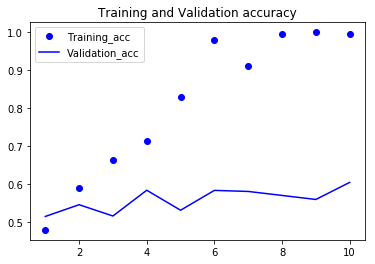

In [76]:
plt.plot(epochs, acc, 'bo', label='Training_acc')
plt.plot(epochs, val_acc, 'b', label='Validation_acc')
plt.title('Training and Validation accuracy')
plt.legend()

plt.show()


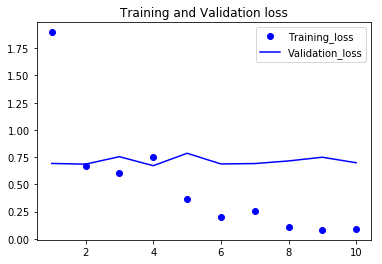

In [78]:
plt.plot(epochs, loss, 'bo', label='Training_loss')
plt.plot(epochs, val_loss, 'b', label='Validation_loss')
plt.title('Training and Validation loss')
plt.legend()

plt.show()